In [1]:
import xarray as xr
from matplotlib.pylab import *
import numpy as np
import pandas as pd
from geopy import distance
from mpl_toolkits.axes_grid1 import make_axes_locatable
from geographiclib.geodesic import Geodesic
import time
from sklearn.metrics import mean_squared_error
from sklearn.model_selection import KFold, cross_validate
from sklearn.neighbors import KNeighborsRegressor
import pickle
from scipy.stats import pearsonr, spearmanr
from sklearn.model_selection import train_test_split
from sklearn.metrics.pairwise import euclidean_distances
from sklearn.preprocessing import StandardScaler

import warnings 
warnings.filterwarnings("ignore", category=RuntimeWarning)
warnings.filterwarnings("ignore", category=DeprecationWarning)

In [2]:
data = xr.open_dataset('raw_data.nc4')
data

<xarray.Dataset>
Dimensions:        (latitude: 77897600, minPressure: 77897600, precipitation: 77897600, radius: 77897600, sst: 77897600, theta: 77897600)
Coordinates:
  * precipitation  (precipitation) float64 0.9693 0.62 0.46 ... 1.36 0.98 0.0
  * radius         (radius) float64 748.6 729.4 710.7 ... 703.3 722.4 742.0
  * theta          (theta) float64 0.6215 0.6481 0.6761 ... 1.04 1.011 0.9845
  * minPressure    (minPressure) float32 997.0 997.0 997.0 ... 998.0 998.0 998.0
  * latitude       (latitude) float32 -12.3 -12.3 -12.3 ... -16.4 -16.4 -16.4
  * sst            (sst) float32 29.06 29.06 29.06 29.06 ... 29.71 29.71 29.71
Data variables:
    *empty*

In [3]:
pmin = data.minPressure.values.reshape(-1,1)
lat = data.latitude.values.reshape(-1,1)
sst = data.sst.values.reshape(-1,1)
dist = data.radius.values.reshape(-1,1)
ang = data.theta.values.reshape(-1,1)

In [4]:
variables = {'Precipitation': data.precipitation.values.reshape(-1,1).ravel(),
             'Radius': dist.ravel(),
             'Theta': ang.ravel(),
             'MinPressure': pmin.ravel(),
             'SST': sst.ravel() ,
             'Latitude': lat.ravel()}

data = pd.DataFrame(variables, columns = ['Precipitation','Radius', 'Theta', 'MinPressure', 'SST', 'Latitude'])
data = data.dropna()

In [5]:
data = data[data.MinPressure > 0]
data = data[data.Radius <= 500]
data.shape

(48308423, 6)

In [6]:
data.head()

,Precipitation,Radius,Theta,MinPressure,SST,Latitude
94,0.30,496.792241,1.107676,997.0,29.059999,-12.3
95,0.38,489.578149,1.160811,997.0,29.059999,-12.3
96,0.74,483.837001,1.215370,997.0,29.059999,-12.3
97,0.56,479.621596,1.271073,997.0,29.059999,-12.3
98,0.90,476.972298,1.327603,997.0,29.059999,-12.3


In [7]:
print(data.Precipitation.min(), data.Precipitation.max())
print(data.Radius.min(), data.Radius.max())
print(data.Theta.min(), data.Theta.max())
print(data.MinPressure.min(), data.MinPressure.max())
print(data.SST.min(), data.SST.max())
print(data.Latitude.min(), data.Latitude.max())

0.0 100.049560546875
0.7489289963020525 499.99979082682086
1.1814942790788763e-07 6.283185301657229
872.0 1024.0
2.9099998474121094 32.05999755859375
-49.5 57.0


In [8]:
print(np.abs(data.Latitude).min(), np.abs(data.Latitude).max())

1.399999976158142 57.0


In [9]:
data = data[np.abs(data.Latitude)<= 49.875]

# Presión Mínima vs Latitud

### Media de la Precipitación 

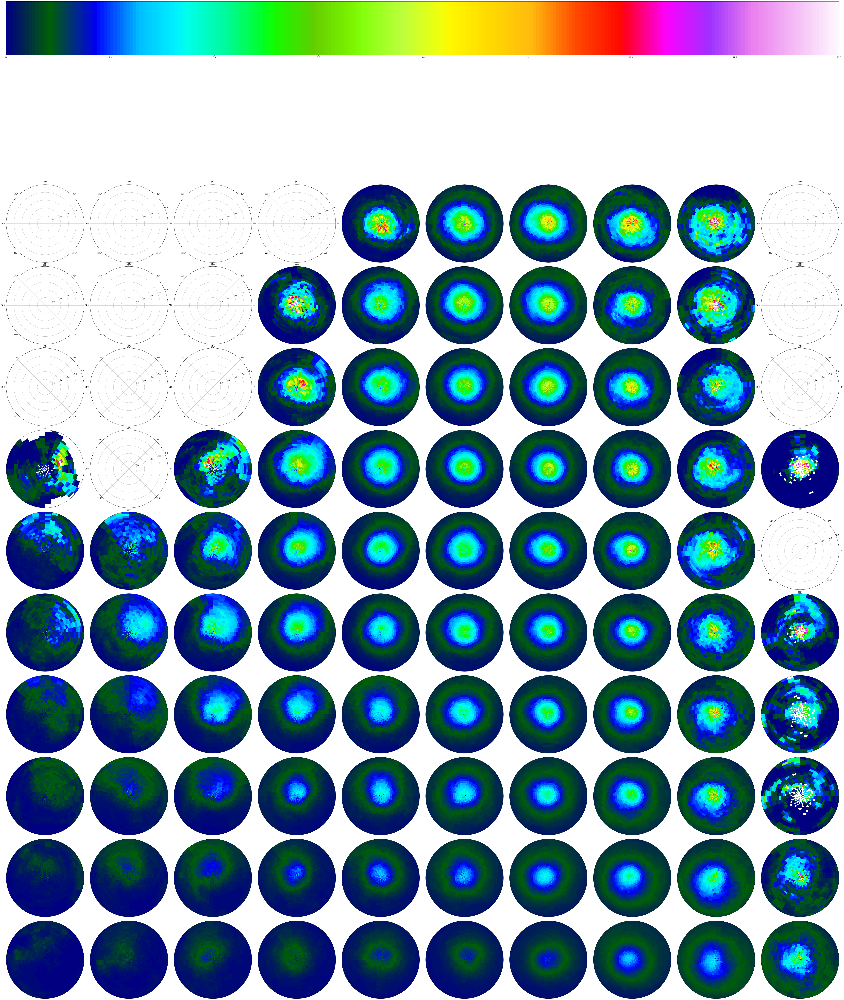

--- 611.3535423278809 seconds ---


In [21]:
total_obs = []

start_time = time.time()
#creación del mesh discretizado que quiero
th = np.array(range(0,370,10)) #discretización de ángulos
radius = np.array(range(0,525,25)) #discretización de radios
r, theta = np.meshgrid(radius,th) #mesh de r y theta

lat_discret = [[50,45],[45,40],[40,35], [35,30],[30,25],[25,20],[20,15],[15,10],[10,5],[5,0]]
pres_discret = [[0,920],[920,930],[930,940],[940,950],[950,960],[960,970],[970,980],[980,990],[990,1000],[1000,1200]]

#creamos fig,axs

fig, axes = plt.subplots(len(pres_discret), len(lat_discret), figsize=(80,80), subplot_kw=dict(polar=True))


cells_obs = []

cells_data = []

for u in range(0,len(pres_discret)):
    for v in range(0,len(lat_discret)): 
        dist = data.Radius.values
        ang = data.Theta.values
        pmin = data.MinPressure.values
        lat = data.Latitude.values
        sst = data.SST.values
        prec = data.Precipitation.values
        
        total_obs = []
        total_idx = []


        idx1 = np.where((pmin > pres_discret[u][0]) & (pmin <= pres_discret[u][1]))
    
        idx2 = np.where((lat < lat_discret[v][0]) & (lat >= lat_discret[v][1]))
    
        idx = np.intersect1d(idx1,idx2)
    
        if len(idx) > 1: #esto es un indicador de que existen observaciones para esa selección de presión y latitud
        
            pmin = pmin[idx]
            lat = lat[idx]
            sst = sst[idx]
            dist = dist[idx]
            ang = ang[idx]
            prec = prec[idx]
    

            obs = np.zeros((r.shape))
                    
            for i in range(obs.shape[0]):
                for j in range(obs.shape[1]):
                    if j == 20 and i == 36 :
                        index = np.intersect1d(np.where((dist <= 500) & (dist >= radius[j])),
                            np.where((ang >= np.radians(th[i]))))
                    elif j == 20:
                        index = np.intersect1d(np.where((dist <= 500) & (dist >= radius[j])),
                            np.where((ang <= np.radians(th[i+1])) & (ang >= np.radians(th[i]))))
                    elif i == 36:
                        index = np.intersect1d(np.where((dist <= radius[j+1]) & (dist >= radius[j])),
                            np.where(((ang >= np.radians(th[i])))))
                    else:
            
                        index = np.intersect1d(np.where((dist <= radius[j+1]) & (dist >= radius[j])),
                            np.where((ang <= np.radians(th[i+1])) & (ang>= np.radians(th[i]))))
                            
                    obs[i,j] = np.nanmean(prec[index]) #cuando el index es un array vacío retorna nan, es decir no hay datos
            
            total_obs.append(obs)
        else:
            continue 

        if len(total_obs) == 0:
        
            axes[u,v].set_theta_zero_location('N', offset=0)

            axes[u,v].set_theta_direction(-1)
    
            axes[u,v].set_yticklabels([])
    
            axes[u,v].set_xticklabels([])
        else:
        
            im = axes[u,v].pcolormesh(np.radians(theta),r, np.nanmean(np.array(total_obs), axis = 0), cmap='gist_ncar', vmin = 0, vmax = 20)

            axes[u,v].set_theta_zero_location('N', offset=0)

            axes[u,v].set_theta_direction(-1)
    
            axes[u,v].set_yticklabels([])
    
            axes[u,v].set_xticklabels([])

p0 = axes[0,0].get_position().get_points().flatten()
p2 = axes[0,v].get_position().get_points().flatten()
ax_cbar1 = fig.add_axes([p0[0], 1, p2[2]-p0[0], 0.05])

plt.colorbar(im, cax=ax_cbar1, orientation='horizontal')

plt.subplots_adjust(wspace=0.05, hspace = 0.05)
plt.show()

print("--- %s seconds ---" % (time.time() - start_time))


### Desviación estándar de la Precipitación 

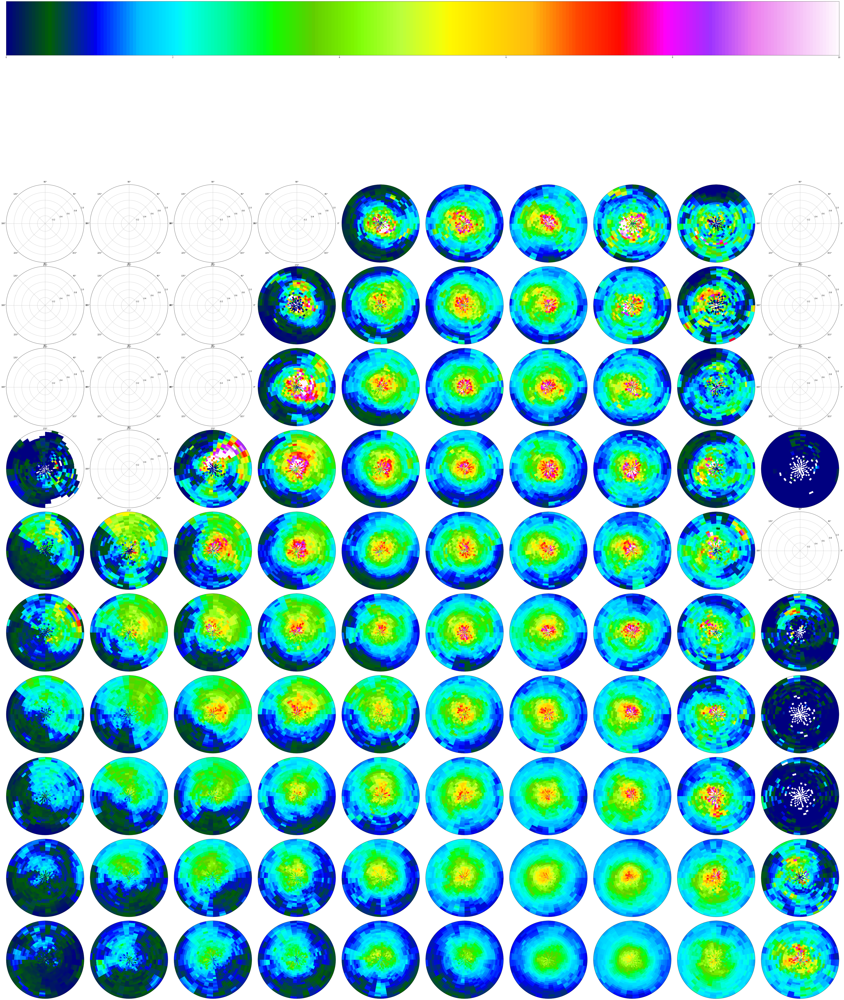

--- 611.9345505237579 seconds ---


In [10]:
total_obs = []

start_time = time.time()
#creación del mesh discretizado que quiero
th = np.array(range(0,370,10)) #discretización de ángulos
radius = np.array(range(0,525,25)) #discretización de radios
r, theta = np.meshgrid(radius,th) #mesh de r y theta

lat_discret = [[50,45],[45,40],[40,35], [35,30],[30,25],[25,20],[20,15],[15,10],[10,5],[5,0]]
pres_discret = [[0,920],[920,930],[930,940],[940,950],[950,960],[960,970],[970,980],[980,990],[990,1000],[1000,1200]]

#creamos fig,axs

fig, axes = plt.subplots(len(pres_discret), len(lat_discret), figsize=(80,80), subplot_kw=dict(polar=True))


cells_obs = []

cells_data = []

all_obs = []

for u in range(0,len(pres_discret)):
    for v in range(0,len(lat_discret)): 
        dist = data.Radius.values
        ang = data.Theta.values
        pmin = data.MinPressure.values
        lat = data.Latitude.values
        sst = data.SST.values
        prec = data.Precipitation.values
        
        total_obs = []
        total_idx = []


        idx1 = np.where((pmin > pres_discret[u][0]) & (pmin <= pres_discret[u][1]))
    
        idx2 = np.where((lat < lat_discret[v][0]) & (lat >= lat_discret[v][1]))
    
        idx = np.intersect1d(idx1,idx2)
    
        if len(idx) > 1: #esto es un indicador de que existen observaciones para esa selección de presión y latitud
        
            pmin = pmin[idx]
            lat = lat[idx]
            sst = sst[idx]
            dist = dist[idx]
            ang = ang[idx]
            prec = prec[idx]
    

            obs = np.zeros((r.shape))
                    
            for i in range(obs.shape[0]):
                for j in range(obs.shape[1]):
                    if j == 20 and i == 36 :
                        index = np.intersect1d(np.where((dist <= 500) & (dist >= radius[j])),
                            np.where((ang >= np.radians(th[i]))))
                    elif j == 20:
                        index = np.intersect1d(np.where((dist <= 500) & (dist >= radius[j])),
                            np.where((ang <= np.radians(th[i+1])) & (ang >= np.radians(th[i]))))
                    elif i == 36:
                        index = np.intersect1d(np.where((dist <= radius[j+1]) & (dist >= radius[j])),
                            np.where(((ang >= np.radians(th[i])))))
                    else:
            
                        index = np.intersect1d(np.where((dist <= radius[j+1]) & (dist >= radius[j])),
                            np.where((ang <= np.radians(th[i+1])) & (ang>= np.radians(th[i]))))
                            
                    obs[i,j] = np.nanstd(prec[index]) #cuando el index es un array vacío retorna nan, es decir no hay datos
            
            total_obs.append(obs)
            all_obs.append(obs)
        else:
            continue 

        if len(total_obs) == 0:
        
            axes[u,v].set_theta_zero_location('N', offset=0)

            axes[u,v].set_theta_direction(-1)
    
            axes[u,v].set_yticklabels([])
    
            axes[u,v].set_xticklabels([])
        else:
        
            im = axes[u,v].pcolormesh(np.radians(theta),r, np.nanmean(np.array(total_obs), axis = 0), cmap='gist_ncar', vmin = 0, vmax = 10)

            axes[u,v].set_theta_zero_location('N', offset=0)

            axes[u,v].set_theta_direction(-1)
    
            axes[u,v].set_yticklabels([])
    
            axes[u,v].set_xticklabels([])

p0 = axes[0,0].get_position().get_points().flatten()
p2 = axes[0,v].get_position().get_points().flatten()
ax_cbar1 = fig.add_axes([p0[0], 1, p2[2]-p0[0], 0.05])

plt.colorbar(im, cax=ax_cbar1, orientation='horizontal')

plt.subplots_adjust(wspace=0.05, hspace = 0.05)
plt.show()

print("--- %s seconds ---" % (time.time() - start_time))
fig.savefig('pmin_lat_std.png')

# SST vs Latitud

### Media de la Precipitación 

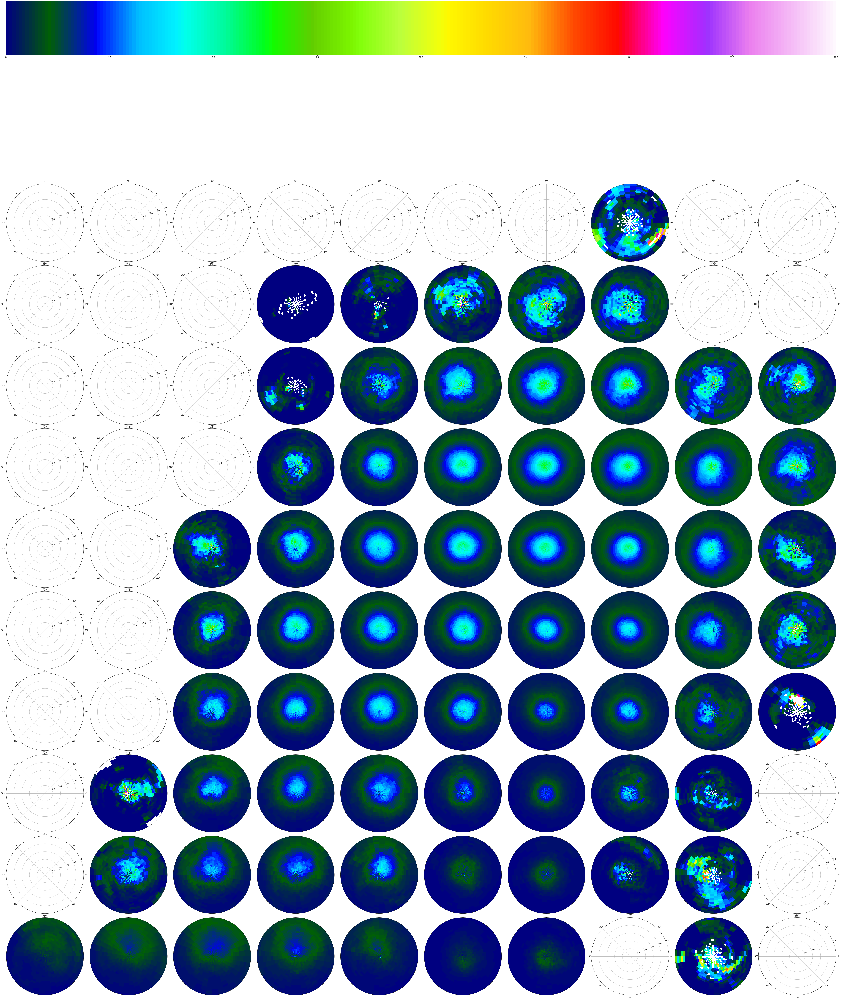

--- 627.6159341335297 seconds ---


In [25]:
total_obs = []

start_time = time.time()
#creación del mesh discretizado que quiero
th = np.array(range(0,370,10)) #discretización de ángulos
radius = np.array(range(0,525,25)) #discretización de radios
r, theta = np.meshgrid(radius,th) #mesh de r y theta

lat_discret = [[50,45],[45,40],[40,35], [35,30],[30,25],[25,20],[20,15],[15,10],[10,5],[5,0]]
sst_discret = [[50,32],[32,31],[31,30], [30,29],[29,28],[28,27],[27,26],[26,25],[25,24],[24,0]]

#creamos fig,axs

fig, axes = plt.subplots(len(sst_discret), len(lat_discret), figsize=(80,80), subplot_kw=dict(polar=True))


cells_obs = []

cells_data = []

for u in range(0,len(sst_discret)):
    for v in range(0,len(lat_discret)): 
        dist = data.Radius.values
        ang = data.Theta.values
        pmin = data.MinPressure.values
        lat = data.Latitude.values
        sst = data.SST.values
        prec = data.Precipitation.values
        
        total_obs = []
        total_idx = []


        idx1 = np.where((sst < sst_discret[u][0]) & (sst >= sst_discret[u][1]))
    
        idx2 = np.where((lat < lat_discret[v][0]) & (lat >= lat_discret[v][1]))
    
        idx = np.intersect1d(idx1,idx2)
    
        if len(idx) > 1: #esto es un indicador de que existen observaciones para esa selección de presión y latitud
        
            pmin = pmin[idx]
            lat = lat[idx]
            sst = sst[idx]
            dist = dist[idx]
            ang = ang[idx]
            prec = prec[idx]
    

            obs = np.zeros((r.shape))
                    
            for i in range(obs.shape[0]):
                for j in range(obs.shape[1]):
                    if j == 20 and i == 36 :
                        index = np.intersect1d(np.where((dist <= 500) & (dist >= radius[j])),
                            np.where((ang >= np.radians(th[i]))))
                    elif j == 20:
                        index = np.intersect1d(np.where((dist <= 500) & (dist >= radius[j])),
                            np.where((ang <= np.radians(th[i+1])) & (ang >= np.radians(th[i]))))
                    elif i == 36:
                        index = np.intersect1d(np.where((dist <= radius[j+1]) & (dist >= radius[j])),
                            np.where(((ang >= np.radians(th[i])))))
                    else:
            
                        index = np.intersect1d(np.where((dist <= radius[j+1]) & (dist >= radius[j])),
                            np.where((ang <= np.radians(th[i+1])) & (ang>= np.radians(th[i]))))
                            
                    obs[i,j] = np.nanmean(prec[index]) #cuando el index es un array vacío retorna nan, es decir no hay datos
            
            total_obs.append(obs)
        else:
            continue 

        if len(total_obs) == 0:
        
            axes[u,v].set_theta_zero_location('N', offset=0)

            axes[u,v].set_theta_direction(-1)
    
            axes[u,v].set_yticklabels([])
    
            axes[u,v].set_xticklabels([])
        else:
        
            im = axes[u,v].pcolormesh(np.radians(theta),r, np.nanmean(np.array(total_obs), axis = 0), cmap='gist_ncar', vmin = 0, vmax = 20)

            axes[u,v].set_theta_zero_location('N', offset=0)

            axes[u,v].set_theta_direction(-1)
    
            axes[u,v].set_yticklabels([])
    
            axes[u,v].set_xticklabels([])

p0 = axes[0,0].get_position().get_points().flatten()
p2 = axes[0,v].get_position().get_points().flatten()
ax_cbar1 = fig.add_axes([p0[0], 1, p2[2]-p0[0], 0.05])

plt.colorbar(im, cax=ax_cbar1, orientation='horizontal')

plt.subplots_adjust(wspace=0.05, hspace = 0.05)
plt.show()

print("--- %s seconds ---" % (time.time() - start_time))


### Desviación estándar de la Precipitación 

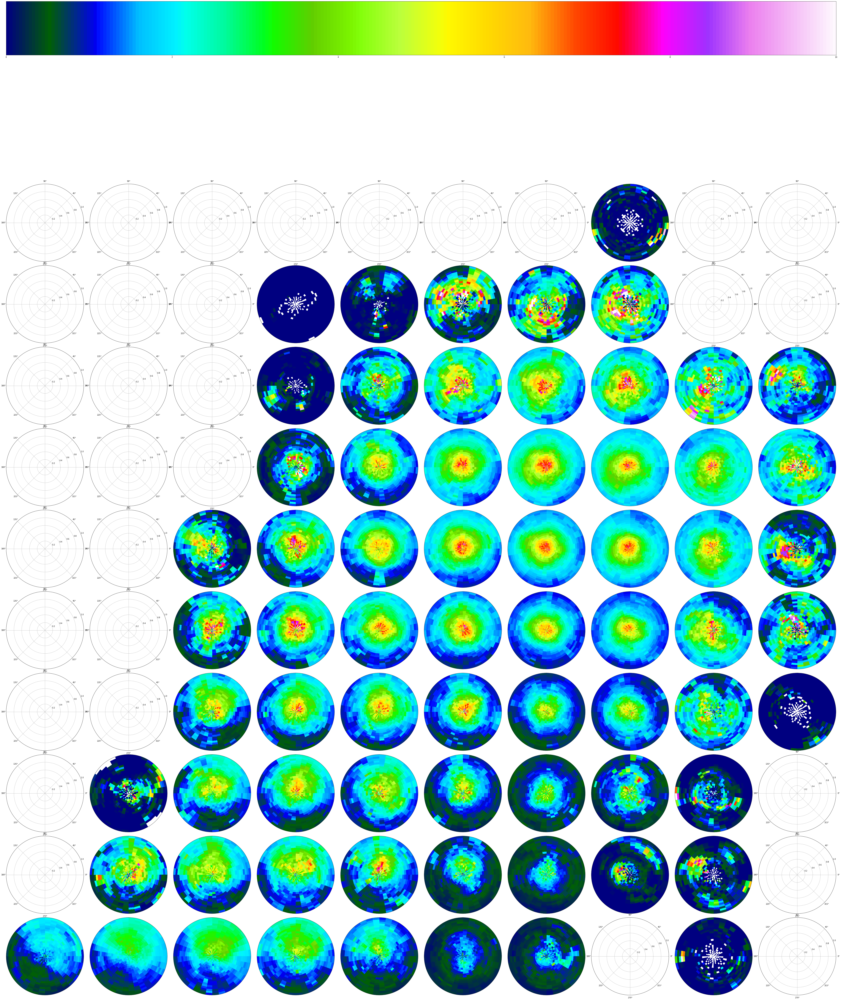

--- 620.8740863800049 seconds ---


In [11]:
total_obs = []

start_time = time.time()
#creación del mesh discretizado que quiero
th = np.array(range(0,370,10)) #discretización de ángulos
radius = np.array(range(0,525,25)) #discretización de radios
r, theta = np.meshgrid(radius,th) #mesh de r y theta

lat_discret = [[50,45],[45,40],[40,35], [35,30],[30,25],[25,20],[20,15],[15,10],[10,5],[5,0]]
sst_discret = [[50,32],[32,31],[31,30], [30,29],[29,28],[28,27],[27,26],[26,25],[25,24],[24,0]]

#creamos fig,axs

fig, axes = plt.subplots(len(sst_discret), len(lat_discret), figsize=(80,80), subplot_kw=dict(polar=True))


cells_obs = []

cells_data = []

all_obs = []

for u in range(0,len(sst_discret)):
    for v in range(0,len(lat_discret)): 
        dist = data.Radius.values
        ang = data.Theta.values
        pmin = data.MinPressure.values
        lat = data.Latitude.values
        sst = data.SST.values
        prec = data.Precipitation.values
        
        total_obs = []
        total_idx = []


        idx1 = np.where((sst < sst_discret[u][0]) & (sst >= sst_discret[u][1]))
    
        idx2 = np.where((lat < lat_discret[v][0]) & (lat >= lat_discret[v][1]))
    
        idx = np.intersect1d(idx1,idx2)
    
        if len(idx) > 1: #esto es un indicador de que existen observaciones para esa selección de presión y latitud
        
            pmin = pmin[idx]
            lat = lat[idx]
            sst = sst[idx]
            dist = dist[idx]
            ang = ang[idx]
            prec = prec[idx]
    

            obs = np.zeros((r.shape))
                    
            for i in range(obs.shape[0]):
                for j in range(obs.shape[1]):
                    if j == 20 and i == 36 :
                        index = np.intersect1d(np.where((dist <= 500) & (dist >= radius[j])),
                            np.where((ang >= np.radians(th[i]))))
                    elif j == 20:
                        index = np.intersect1d(np.where((dist <= 500) & (dist >= radius[j])),
                            np.where((ang <= np.radians(th[i+1])) & (ang >= np.radians(th[i]))))
                    elif i == 36:
                        index = np.intersect1d(np.where((dist <= radius[j+1]) & (dist >= radius[j])),
                            np.where(((ang >= np.radians(th[i])))))
                    else:
            
                        index = np.intersect1d(np.where((dist <= radius[j+1]) & (dist >= radius[j])),
                            np.where((ang <= np.radians(th[i+1])) & (ang>= np.radians(th[i]))))
                            
                    obs[i,j] = np.nanstd(prec[index]) #cuando el index es un array vacío retorna nan, es decir no hay datos
            
            total_obs.append(obs)
            all_obs.append(obs)
        else:
            continue 

        if len(total_obs) == 0:
        
            axes[u,v].set_theta_zero_location('N', offset=0)

            axes[u,v].set_theta_direction(-1)
    
            axes[u,v].set_yticklabels([])
    
            axes[u,v].set_xticklabels([])
        else:
        
            im = axes[u,v].pcolormesh(np.radians(theta),r, np.nanmean(np.array(total_obs), axis = 0), cmap='gist_ncar', vmin = 0, vmax = 10)

            axes[u,v].set_theta_zero_location('N', offset=0)

            axes[u,v].set_theta_direction(-1)
    
            axes[u,v].set_yticklabels([])
    
            axes[u,v].set_xticklabels([])

p0 = axes[0,0].get_position().get_points().flatten()
p2 = axes[0,v].get_position().get_points().flatten()
ax_cbar1 = fig.add_axes([p0[0], 1, p2[2]-p0[0], 0.05])

plt.colorbar(im, cax=ax_cbar1, orientation='horizontal')

plt.subplots_adjust(wspace=0.05, hspace = 0.05)
plt.show()

print("--- %s seconds ---" % (time.time() - start_time))
fig.savefig('lat_sst_std.png')

# Presión Mínima vs SST

### Media de la Precipitación 

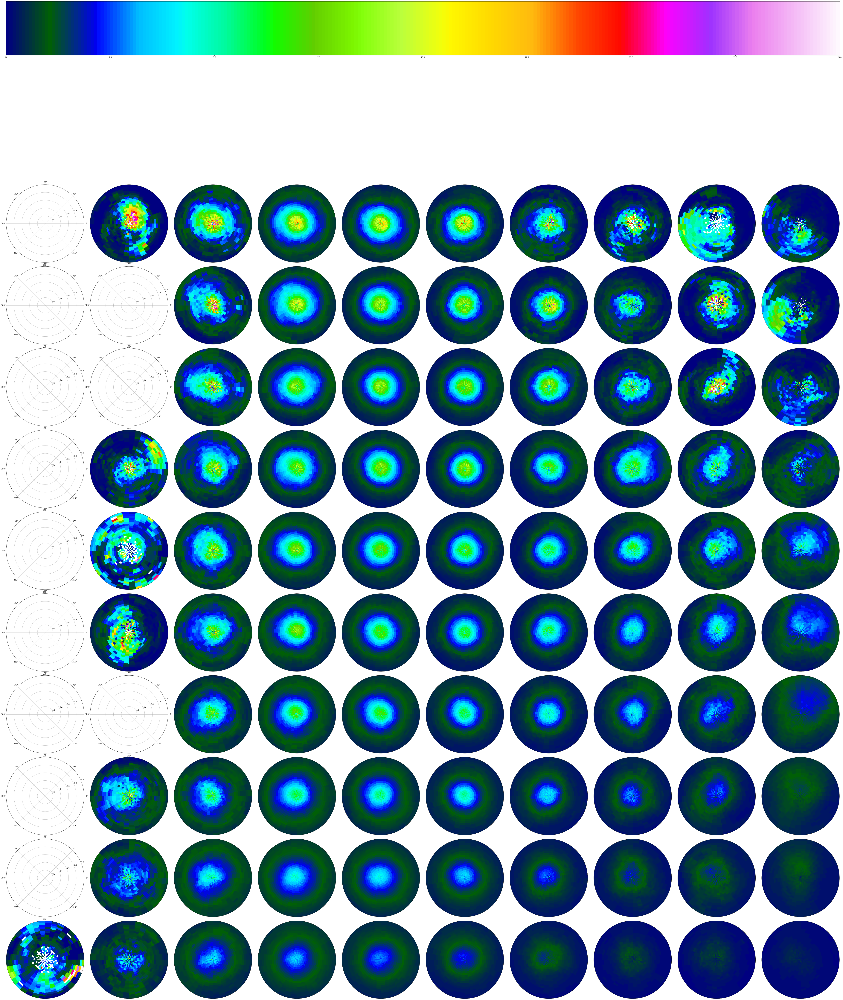

--- 827.6235122680664 seconds ---


In [28]:
total_obs = []

start_time = time.time()
#creación del mesh discretizado que quiero
th = np.array(range(0,370,10)) #discretización de ángulos
radius = np.array(range(0,525,25)) #discretización de radios
r, theta = np.meshgrid(radius,th) #mesh de r y theta

pres_discret = [[0,920],[920,930],[930,940],[940,950],[950,960],[960,970],[970,980],[980,990],[990,1000],[1000,1200]]
sst_discret = [[50,32],[32,31],[31,30], [30,29],[29,28],[28,27],[27,26],[26,25],[25,24],[24,0]]

#creamos fig,axs

fig, axes = plt.subplots(len(pres_discret), len(sst_discret), figsize=(80,80), subplot_kw=dict(polar=True))


cells_obs = []

cells_data = []

for u in range(0,len(pres_discret)):
    for v in range(0,len(sst_discret)): 
        dist = data.Radius.values
        ang = data.Theta.values
        pmin = data.MinPressure.values
        lat = data.Latitude.values
        sst = data.SST.values
        prec = data.Precipitation.values
        
        total_obs = []
        total_idx = []


        idx1 = np.where((sst < sst_discret[v][0]) & (sst >= sst_discret[v][1]))
    
        idx2 = np.where((pmin > pres_discret[u][0]) & (pmin <= pres_discret[u][1]))
    
        idx = np.intersect1d(idx1,idx2)
    
        if len(idx) > 1: #esto es un indicador de que existen observaciones para esa selección de presión y latitud
        
            pmin = pmin[idx]
            lat = lat[idx]
            sst = sst[idx]
            dist = dist[idx]
            ang = ang[idx]
            prec = prec[idx]
    

            obs = np.zeros((r.shape))
                    
            for i in range(obs.shape[0]):
                for j in range(obs.shape[1]):
                    if j == 20 and i == 36 :
                        index = np.intersect1d(np.where((dist <= 500) & (dist >= radius[j])),
                            np.where((ang >= np.radians(th[i]))))
                    elif j == 20:
                        index = np.intersect1d(np.where((dist <= 500) & (dist >= radius[j])),
                            np.where((ang <= np.radians(th[i+1])) & (ang >= np.radians(th[i]))))
                    elif i == 36:
                        index = np.intersect1d(np.where((dist <= radius[j+1]) & (dist >= radius[j])),
                            np.where(((ang >= np.radians(th[i])))))
                    else:
            
                        index = np.intersect1d(np.where((dist <= radius[j+1]) & (dist >= radius[j])),
                            np.where((ang <= np.radians(th[i+1])) & (ang>= np.radians(th[i]))))
                            
                    obs[i,j] = np.nanmean(prec[index]) #cuando el index es un array vacío retorna nan, es decir no hay datos
            
            total_obs.append(obs)
        else:
            continue 

        if len(total_obs) == 0:
        
            axes[u,v].set_theta_zero_location('N', offset=0)

            axes[u,v].set_theta_direction(-1)
    
            axes[u,v].set_yticklabels([])
    
            axes[u,v].set_xticklabels([])
        else:
        
            im = axes[u,v].pcolormesh(np.radians(theta),r, np.nanmean(np.array(total_obs), axis = 0), cmap='gist_ncar', vmin = 0, vmax = 20)

            axes[u,v].set_theta_zero_location('N', offset=0)

            axes[u,v].set_theta_direction(-1)
    
            axes[u,v].set_yticklabels([])
    
            axes[u,v].set_xticklabels([])

p0 = axes[0,0].get_position().get_points().flatten()
p2 = axes[0,v].get_position().get_points().flatten()
ax_cbar1 = fig.add_axes([p0[0], 1, p2[2]-p0[0], 0.05])

plt.colorbar(im, cax=ax_cbar1, orientation='horizontal')

plt.subplots_adjust(wspace=0.05, hspace = 0.05)
plt.show()

print("--- %s seconds ---" % (time.time() - start_time))


### Desviación Estándar de la Precipitación 

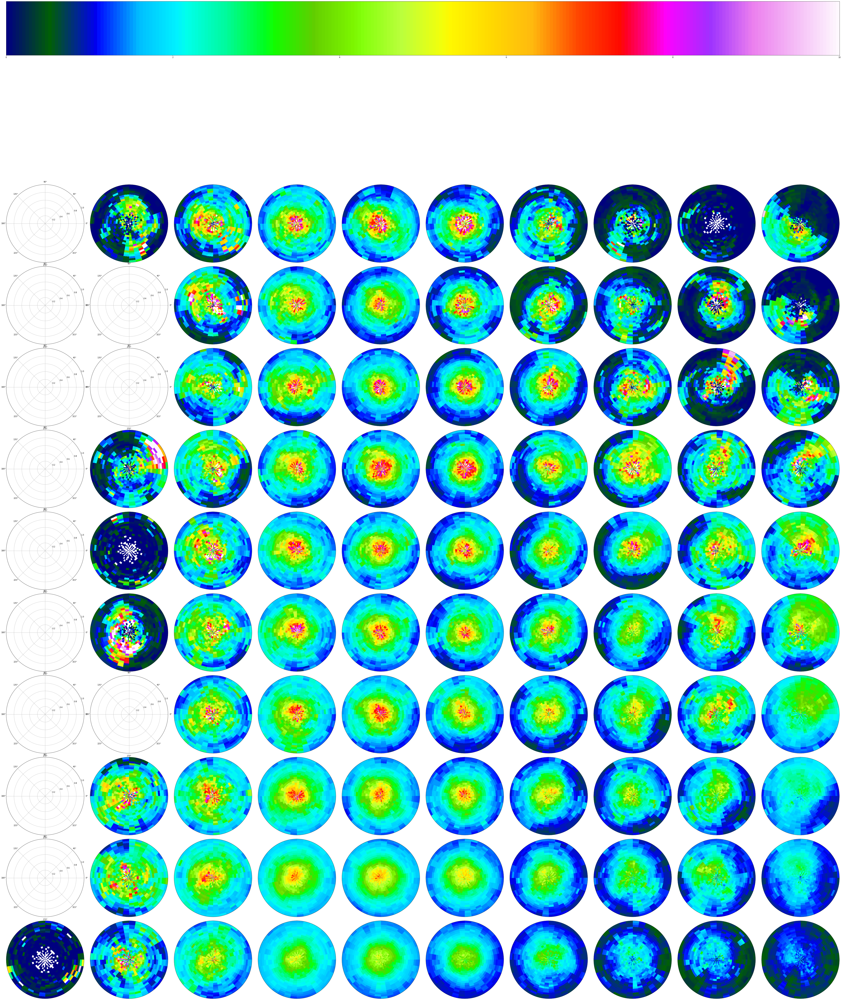

--- 836.3006067276001 seconds ---


In [12]:
total_obs = []

start_time = time.time()
#creación del mesh discretizado que quiero
th = np.array(range(0,370,10)) #discretización de ángulos
radius = np.array(range(0,525,25)) #discretización de radios
r, theta = np.meshgrid(radius,th) #mesh de r y theta

pres_discret = [[0,920],[920,930],[930,940],[940,950],[950,960],[960,970],[970,980],[980,990],[990,1000],[1000,1200]]
sst_discret = [[50,32],[32,31],[31,30], [30,29],[29,28],[28,27],[27,26],[26,25],[25,24],[24,0]]

#creamos fig,axs

fig, axes = plt.subplots(len(pres_discret), len(sst_discret), figsize=(80,80), subplot_kw=dict(polar=True))


cells_obs = []

cells_data = []

all_obs = []

for u in range(0,len(pres_discret)):
    for v in range(0,len(sst_discret)): 
        dist = data.Radius.values
        ang = data.Theta.values
        pmin = data.MinPressure.values
        lat = data.Latitude.values
        sst = data.SST.values
        prec = data.Precipitation.values
        
        total_obs = []
        total_idx = []


        idx1 = np.where((sst < sst_discret[v][0]) & (sst >= sst_discret[v][1]))
    
        idx2 = np.where((pmin > pres_discret[u][0]) & (pmin <= pres_discret[u][1]))
    
        idx = np.intersect1d(idx1,idx2)
    
        if len(idx) > 1: #esto es un indicador de que existen observaciones para esa selección de presión y latitud
        
            pmin = pmin[idx]
            lat = lat[idx]
            sst = sst[idx]
            dist = dist[idx]
            ang = ang[idx]
            prec = prec[idx]
    

            obs = np.zeros((r.shape))
                    
            for i in range(obs.shape[0]):
                for j in range(obs.shape[1]):
                    if j == 20 and i == 36 :
                        index = np.intersect1d(np.where((dist <= 500) & (dist >= radius[j])),
                            np.where((ang >= np.radians(th[i]))))
                    elif j == 20:
                        index = np.intersect1d(np.where((dist <= 500) & (dist >= radius[j])),
                            np.where((ang <= np.radians(th[i+1])) & (ang >= np.radians(th[i]))))
                    elif i == 36:
                        index = np.intersect1d(np.where((dist <= radius[j+1]) & (dist >= radius[j])),
                            np.where(((ang >= np.radians(th[i])))))
                    else:
            
                        index = np.intersect1d(np.where((dist <= radius[j+1]) & (dist >= radius[j])),
                            np.where((ang <= np.radians(th[i+1])) & (ang>= np.radians(th[i]))))
                            
                    obs[i,j] = np.nanstd(prec[index]) #cuando el index es un array vacío retorna nan, es decir no hay datos
            
            total_obs.append(obs)
            all_obs.append(obs)
        else:
            continue 

        if len(total_obs) == 0:
        
            axes[u,v].set_theta_zero_location('N', offset=0)

            axes[u,v].set_theta_direction(-1)
    
            axes[u,v].set_yticklabels([])
    
            axes[u,v].set_xticklabels([])
        else:
        
            im = axes[u,v].pcolormesh(np.radians(theta),r, np.nanmean(np.array(total_obs), axis = 0), cmap='gist_ncar', vmin = 0, vmax = 10)

            axes[u,v].set_theta_zero_location('N', offset=0)

            axes[u,v].set_theta_direction(-1)
    
            axes[u,v].set_yticklabels([])
    
            axes[u,v].set_xticklabels([])

p0 = axes[0,0].get_position().get_points().flatten()
p2 = axes[0,v].get_position().get_points().flatten()
ax_cbar1 = fig.add_axes([p0[0], 1, p2[2]-p0[0], 0.05])

plt.colorbar(im, cax=ax_cbar1, orientation='horizontal')

plt.subplots_adjust(wspace=0.05, hspace = 0.05)
plt.show()

print("--- %s seconds ---" % (time.time() - start_time))
fig.savefig('pmin_sst_std.png')